# Download image files

In [ ]:
!wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1ktuKqlB6fXrYs_-0tc4TlvDfL0_Xao4i' -O Lena.png
!wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=18fbzSR80lQ6t9rvS67CSIMQBDalYK1Lt' -O dog.tif
!wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1bsKGmmUnVEuQN5XepxjHyQ-qIQjgaZdn' -O images.zip

!unzip images.zip -d images/

--2021-04-18 14:14:35--  https://docs.google.com/uc?export=download&id=1ktuKqlB6fXrYs_-0tc4TlvDfL0_Xao4i
Resolving docs.google.com (docs.google.com)... 142.250.1.113, 142.250.1.102, 142.250.1.101, ...
Connecting to docs.google.com (docs.google.com)|142.250.1.113|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-14-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8dgf4s02ukn0bt87isisv7botfa2fni7/1618755225000/14943465539724169100/*/1ktuKqlB6fXrYs_-0tc4TlvDfL0_Xao4i?e=download [following]
--2021-04-18 14:14:36--  https://doc-14-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8dgf4s02ukn0bt87isisv7botfa2fni7/1618755225000/14943465539724169100/*/1ktuKqlB6fXrYs_-0tc4TlvDfL0_Xao4i?e=download
Resolving doc-14-3c-docs.googleusercontent.com (doc-14-3c-docs.googleusercontent.com)... 142.250.103.132, 2607:f8b0:4001:c2b::84
Connecting to doc-14-3c-docs.googleusercontent.com (doc-14-3c-docs

# Question 1

Download Lena color image convert it to grayscale image and add salt and  pepper noise with noise quantity 0.1,0.2 upto 1 and generate 10 noisy
images.
<br> **a)** Do average filtering ( by correlating with average filter ) of varying sizes for each image. Filter size can be 3*3, 5*5, 7*7. (In 3*3 filter all the values are
1/9, in 5*5 filter all the values are 1/25 and in 7*7 filter all the values are 1/49)
<br>**b)** Similarly, repeat the question 1.a by replacing the average filter by median filter.

original image:


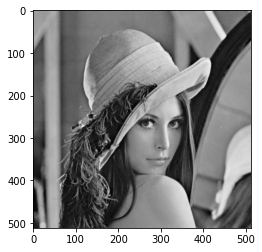

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.util import random_noise
import scipy.signal as signal # to compare with inbuilt functions

img=cv2.imread("images/Lena.png",0)
print("original image:")
plt.imshow(img,cmap="gray")
plt.show()

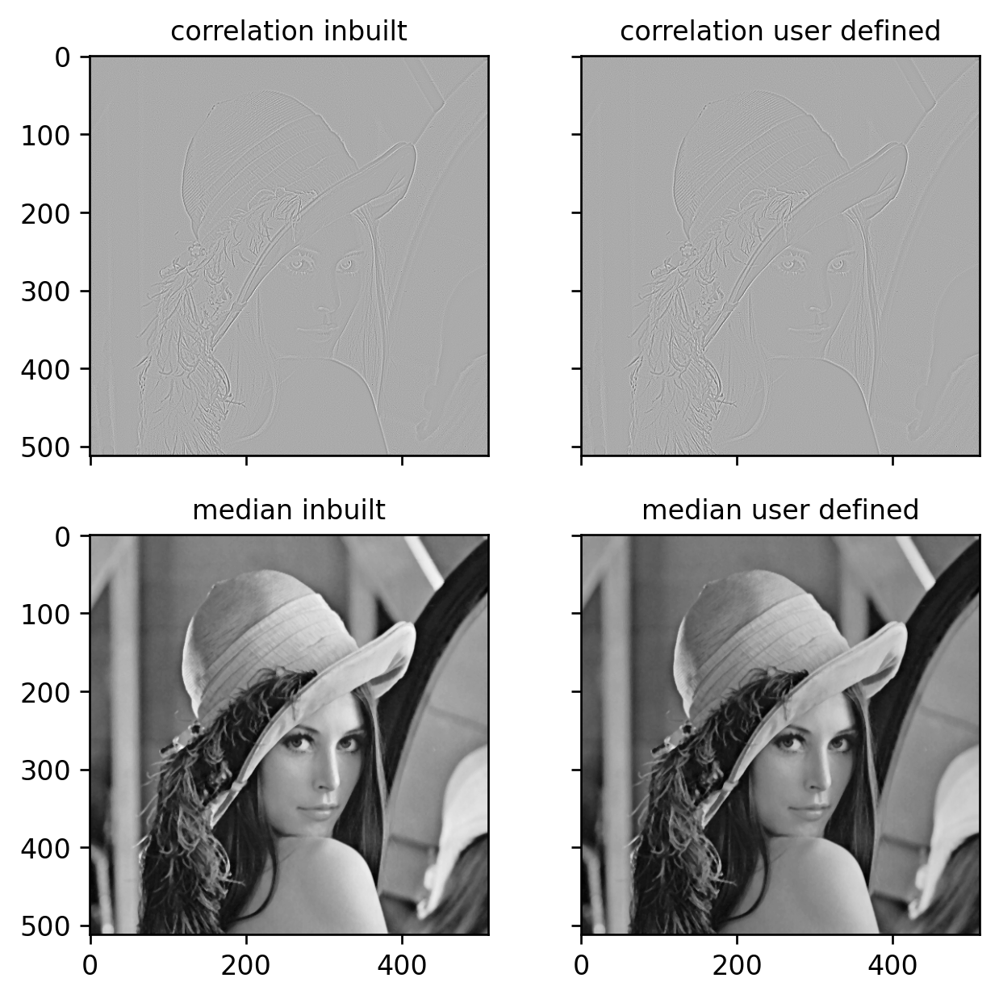

% error:
correlation: 0.0
median: 1.5560150146484375


In [24]:
def correlate2d(img,w):

    w_x=w.shape[0]
    w_y=w.shape[1]
    img_padded=np.zeros((img.shape[0]+w_x-1,img.shape[1]+w_y-1))
    x_shift=w_x//2
    y_shift=w_y//2
    extra_x= 1 if w_x%2==0 else 0
    extra_y= 1 if w_y%2==0 else 0
    img_padded[x_shift:-x_shift+extra_x,y_shift:-y_shift+extra_y]=img

    corr=np.empty_like(img,dtype=float)
    for x in range(corr.shape[0]):
        for y in range(corr.shape[1]):
            corr[x][y]=np.sum(np.multiply(img_padded[x:x+w_x,y:y+w_y],w))

    return corr

def median_filter(img,window_size):

    img_padded=np.full((img.shape[0]+window_size-1,img.shape[1]+window_size-1),-1)
    shift=window_size//2
    img_padded[shift:-shift,shift:-shift]=img

    size_=window_size**2
    median_img=np.empty_like(img)
    for x in range(median_img.shape[0]):
        for y in range(median_img.shape[1]):
            candidates=np.reshape(img_padded[x:x+window_size,y:y+window_size],(size_))
            if x<shift or y<shift:
                candidates=candidates[candidates!=-1]
            median_img[x,y]=np.median(candidates)

    return median_img

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(6,6), dpi=240, sharex=True, sharey=True)

w=np.array([[0,1,0],[1,-4,1],[0,1,0]])
corr_inbuilt=signal.correlate2d(img,w,mode='same')
corr_userdefined=correlate2d(img,w)

median_userdefined=median_filter(img,3)
median_inbuilt=cv2.medianBlur(img,3)

ax[0][0].imshow(corr_inbuilt, cmap="gray")
ax[0][0].set_title(f"correlation inbuilt",fontsize=10)

ax[0][1].imshow(corr_userdefined, cmap="gray")
ax[0][1].set_title(f"correlation user defined",fontsize=10)

ax[1][0].imshow(median_inbuilt, cmap="gray")
ax[1][0].set_title(f"median inbuilt",fontsize=10)

ax[1][1].imshow(median_userdefined, cmap="gray")
ax[1][1].set_title(f"median user defined",fontsize=10)

plt.show()

print(f'% error:\ncorrelation: {np.mean(np.abs(corr_inbuilt-corr_userdefined))*100}\nmedian: {np.mean(np.abs(median_inbuilt-median_userdefined))*100}');

avg filter window for window size 3:
[[0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]]
avg filter window for window size 5:
[[0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]]
avg filter window for window size 7:
[[0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]]


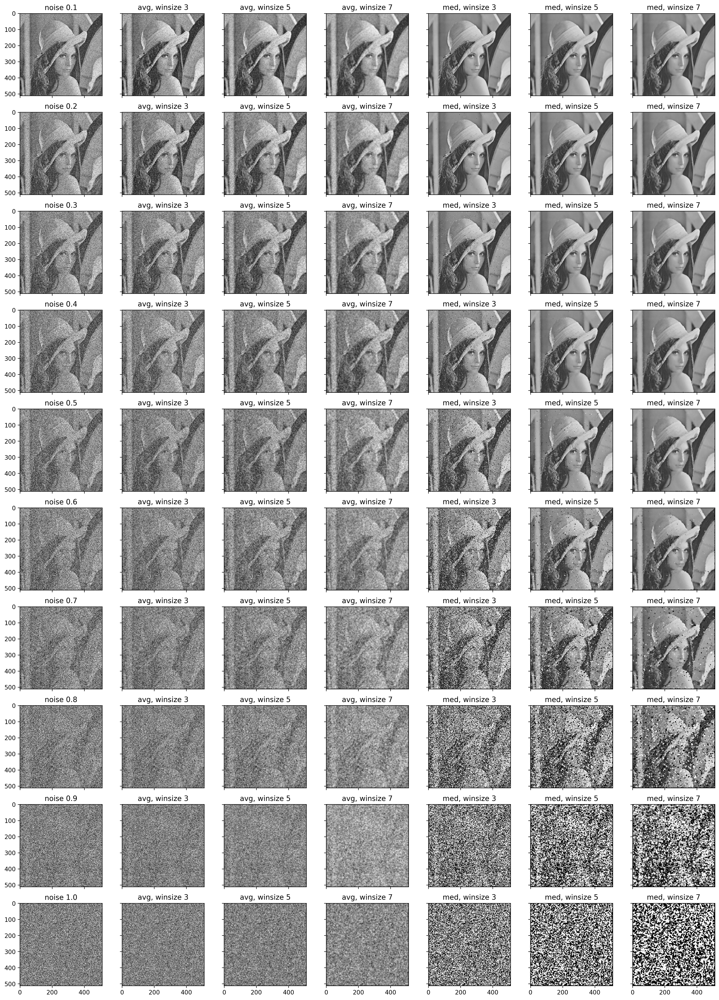

In [8]:
fig, ax = plt.subplots(nrows=10, ncols=7, figsize=(21,30), dpi=240, sharex=True, sharey=True)

images_with_noise=[]
for i in range(1,11):
    images_with_noise.append((random_noise(img, mode="s&p", amount=i/10)*255).astype(np.uint8))
    ax[i-1][0].imshow(images_with_noise[-1], cmap="gray")
    ax[i-1][0].set_title(f"noise {i/10}",fontsize=12)
    
sizes=[3,5,7]

for size,col_index in zip(sizes,[1,2,3]):
    
    w=np.array([[1/size**2]*size]*size)
    print(f"avg filter window for window size {size}:\n{w}")
    
    for i,noise_img in enumerate(images_with_noise):
        
        avg_img=correlate2d(noise_img,w)
        ax[i][col_index].imshow(avg_img,cmap="gray")
        ax[i][col_index].set_title(f"avg, winsize {size}",fontsize=12)
        
        median_img=median_filter(noise_img,size)
        ax[i][col_index+3].imshow(median_img,cmap="gray")
        ax[i][col_index+3].set_title(f"med, winsize {size}",fontsize=12)
        
plt.show()

# Question 2

In [10]:
def normalised_cross_correlation(f,w):
    
    assert (f.ndim==2 and w.ndim==2),"both f and w must be greyscale images"
    f_mean=np.mean(f)
    w_mean=np.mean(w)
    f_=f-f_mean
    w_=w-w_mean
    corr=correlate2d(f_,w_)
    norm=(np.sum(np.square(f_))*np.sum(np.square(w_)))**0.5
    return corr/norm

def mark_point_and_draw_box(img,center,left_top,right_bottom):
    
    # indices have to be reversed since opencv uses column, row notation
    
    x=tuple(center[::-1])
    cv2.circle(img, x, 6, color=(255,0,0), thickness=-1)
    
    x=tuple(center[::-1]-[10,10])
    y=tuple(center[::-1]+[10,10])
    cv2.line(img, x, y, (255,0,0), 2)
    
    x=tuple(center[::-1]+[10,-10])
    y=tuple(center[::-1]+[-10,10])
    cv2.line(img, x, y, (255,0,0), 2)
    
    x=tuple(left_top[::-1])
    y=tuple(right_bottom[::-1])
    cv2.rectangle(img, x, y, color=(255,0,0), thickness=2)

def locate(f,w):
    
    # get matching locations
    ncc_mat=normalised_cross_correlation(f,w)
    std=np.std(ncc_mat)
    T=np.amax(ncc_mat)-std*0.01
    locs=np.argwhere(ncc_mat>=T)
    shift=np.array(w.shape)//2
    
    # draw rectangles over matched areas
    output_img=cv2.cvtColor(f,cv2.COLOR_GRAY2BGR)
    for center,s,e in zip(locs,locs-shift,locs+shift):
        mark_point_and_draw_box(output_img,center,s,e)
    
    return output_img,locs

## Part a
Consider the image the attached named as hdraw.png and crop each of the characters from the image and consider that as the sub-image. Find the
location of the sub-image in the original by using correlation.

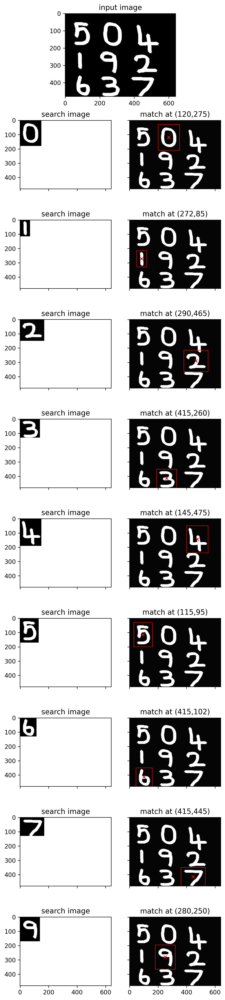

In [11]:
hdraw=np.array(cv2.imread("images/hdraw.png",0))

hdraw_cropped=[]
for i in [0,1,2,3,4,5,6,7,9]:
    hdraw_cropped.append(np.array(cv2.imread(f"images/hdraw_{i}.png",0)))
    
fig, ax = plt.subplots(nrows=10, ncols=2, figsize=(6,30), dpi=240, sharex=True, sharey=True)

gs = ax[0,0].get_gridspec()
for a in ax[0]:
    a.remove()
axbig = fig.add_subplot(gs[0,:])

axbig.imshow(hdraw,cmap="gray")
axbig.set_title("input image",fontsize=12)

for search_img,row_index in zip(hdraw_cropped,range(1,10)):
    
    ax[row_index][0].imshow(search_img,cmap="gray")
    ax[row_index][0].set_title("search image",fontsize=12)

    box_img,locs=locate(hdraw,search_img)

    ax[row_index][1].imshow(box_img)
    ax[row_index][1].set_title(f"match at ({locs[0][0]},{locs[0][1]})",fontsize=12)
    
plt.show()

## Part b

Download Lena color image convert it to grayscale image and crop the left eye of Lena as sub-image and do the cross-correlation (Normalized
correlation) to find the location of the left eye in the original image.

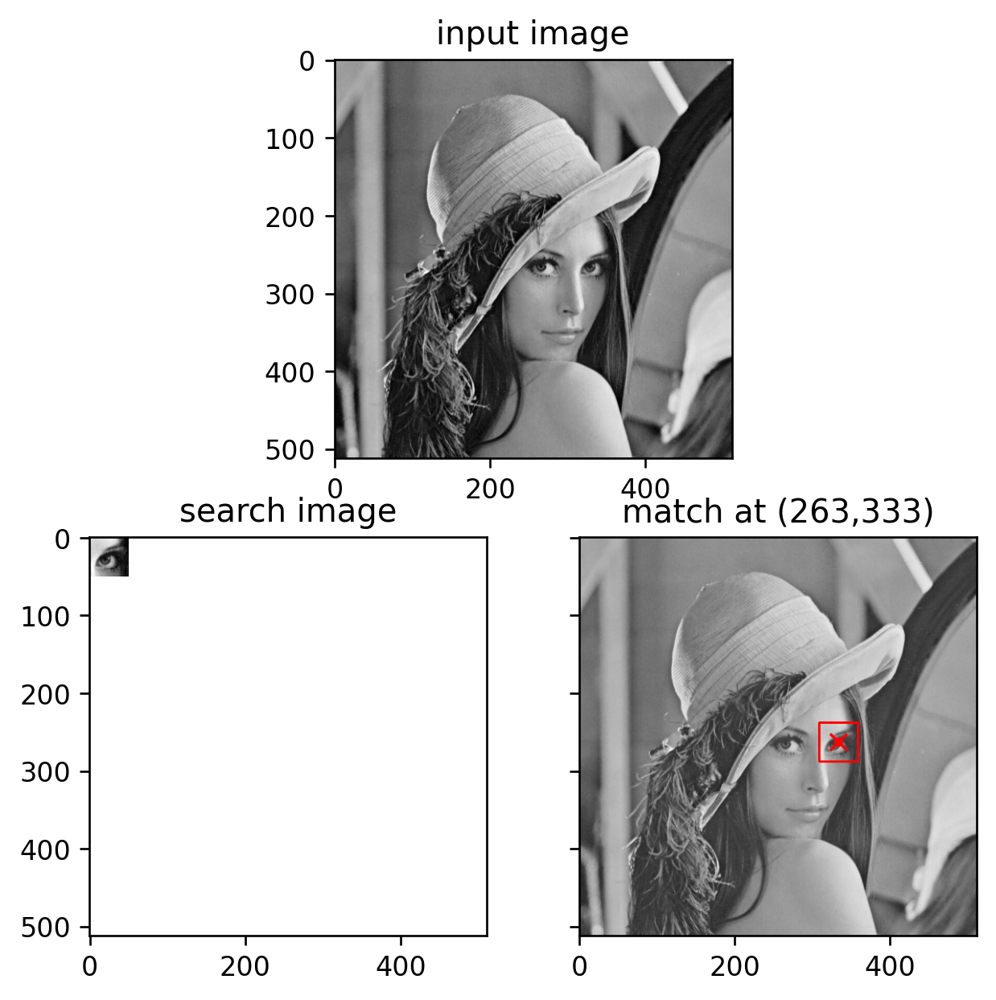

In [12]:
img_np=np.array(img)
left_eye_np=np.array(cv2.imread("images/Lena_left_eye.png",0))

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(6,6), dpi=240, sharex=True, sharey=True)
gs = ax[0,0].get_gridspec()
for a in ax[0]:
    a.remove()
axbig = fig.add_subplot(gs[0,:])

axbig.imshow(img_np,cmap="gray")
axbig.set_title("input image",fontsize=12)

ax[1][0].imshow(left_eye_np,cmap="gray")
ax[1][0].set_title("search image",fontsize=12)

box_img,locs=locate(img_np,left_eye_np)

ax[1][1].imshow(box_img)
ax[1][1].set_title(f"match at ({locs[0][0]},{locs[0][1]})",fontsize=12)

plt.show()

# Question 3
Write a function to implement FFT for 1D signal.

In [ ]:
import cv2
import numpy as np

def FFT_1D(signal):

    n = len(signal)
    if n == 1:
        return signal

    w = np.power(np.e, -2 * np.pi * (1j) / n)
    signal_e = [signal[i] for i in range(len(signal)) if i%2 == 0]
    signal_o = [signal[i] for i in range(len(signal)) if i%2 == 1]

    SIGNAL = [0] * n
    SIGNAL_E = FFT_1D(signal_e)        # like how 'f' is signal in time domain and 'F' is signal in frequency domain,
    SIGNAL_O = FFT_1D(signal_o)        # 'signal' is in time domain and 'SIGNAL' is in frequency domain

    n2 = round(n/2)
    for i in range(n2):
        SIGNAL[i] = SIGNAL_E[i] + np.power(w, i) * SIGNAL_O[i]
        SIGNAL[i+n2] = SIGNAL_E[i] - np.power(w, i) * SIGNAL_O[i]

    return SIGNAL

In [ ]:
arr = np.asarray([0, 1, 2, 3, 4, 5, 6, 7])

ARR_usr = FFT_1D(arr)
ARR_np = np.fft.fft(arr)

print("FFT using user-defined function:")
print(ARR_usr)
print("\nFFT using numpy implementation:")
print(ARR_np)

error = np.real(np.mean(np.conj(ARR_usr)*ARR_usr - np.conj(ARR_np)*ARR_np)) * 100
print(f"\n% Error = {error}")

FFT using user-defined function:
[(28+0j), (-4+9.65685424949238j), (-4.000000000000001+4j), (-4.000000000000002+1.6568542494923797j), (-4+0j), (-3.9999999999999996-1.6568542494923797j), (-3.999999999999999-4j), (-3.999999999999998-9.65685424949238j)]

FFT using numpy implementation:
[28.+0.j         -4.+9.65685425j -4.+4.j         -4.+1.65685425j
 -4.+0.j         -4.-1.65685425j -4.-4.j         -4.-9.65685425j]

% Error = -1.3322676295501878e-13


# Question 4
Implement DFT function for an image using the FFT for 1D signal using question 3.



In [ ]:
img = [ [10, 20, 30, 40],
        [11, 21, 31, 41],
        [12, 22, 32, 42],
        [13, 23, 33, 43]]

In [ ]:
def FFT_2D(img):
    rows_FFT = []
    for i in img:
        rows_FFT.append(FFT_1D(i))
    
    cols_FFT = np.asarray(rows_FFT, dtype=np.complex).T
    IMG = []
    for i in cols_FFT:
        IMG.append(FFT_1D(i))
    return np.asarray(IMG).T

In [ ]:
IMG_usr = FFT_2D(img)
IMG_np = np.fft.fft2(img)

print("FFT using user-defined function:")
print(IMG_usr)
print("\nFFT using numpy implementation:")
print(IMG_np)

error = np.real(np.mean(np.conj(IMG_usr)*IMG_usr - np.conj(IMG_np)*IMG_np)) * 100
print(f"\n% Error = {error}")

FFT using user-defined function:
[[424. +0.j -80.+80.j -80. +0.j -80.-80.j]
 [ -8. +8.j   0. +0.j   0. +0.j   0. +0.j]
 [ -8. +0.j   0. +0.j   0. +0.j   0. +0.j]
 [ -8. -8.j   0. +0.j   0. +0.j   0. +0.j]]

FFT using numpy implementation:
[[424. +0.j -80.+80.j -80. +0.j -80.-80.j]
 [ -8. +8.j   0. +0.j   0. +0.j   0. +0.j]
 [ -8. +0.j   0. +0.j   0. +0.j   0. +0.j]
 [ -8. -8.j   0. +0.j   0. +0.j   0. +0.j]]

% Error = -8.881784197001252e-14


# Question 5
Consider the images of lena and dog images attached. Find phase and magnitude of the dog and lena images using DFT function implemented in question 4.

In [ ]:
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

'''
View the fourier transformed image along with phase and magnitude parts of the transform.
Since it is not possible to view complex values in an image, the functions default to taking
the real part of the pixel values and where ever needed, clip the value to the range [0, 255]
'''
def view_fourier(img):

    img_FFT = FFT_2D(img)
    fig,elements=plt.subplots(nrows=2,ncols=4,figsize=(30,15))

    phase = np.angle(img_FFT, deg=True)
    magnitude = np.log(np.abs(img_FFT))
    
    elements[0,0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    elements[0,0].set_title("Original Image", fontsize=30)
    elements[0,1].imshow(np.real(img_FFT.clip(0, 255)), cmap='gray')
    elements[0,1].set_title("Fourier Transform", fontsize=30)
    elements[0,2].imshow(phase, cmap='gray')
    elements[0,2].set_title("Phase", fontsize=30)
    elements[0,3].imshow(magnitude, cmap='gray')
    elements[0,3].set_title("Magnitude", fontsize=30)

    img_FFT_shifted = np.fft.fftshift(img_FFT)
    phase_shifted = np.angle(img_FFT_shifted, deg=True)
    magnitude_shifted = np.log(np.abs(img_FFT_shifted))     # Normalizing the matrix for visual purposes

    elements[1,0].imshow(img, cmap='gray')
    elements[1,0].set_title("Original Image", fontsize=30)
    elements[1,1].imshow(np.real(img_FFT_shifted.clip(0, 255)), cmap='gray')
    elements[1,1].set_title("Fourier Transform (center shifted)", fontsize=30)
    elements[1,2].imshow(phase_shifted, cmap='gray')
    elements[1,2].set_title("Phase (center shifted)", fontsize=30)
    elements[1,3].imshow(magnitude_shifted, cmap='gray')
    elements[1,3].set_title("Magnitude (center shifted)", fontsize=30)


    plt.show()

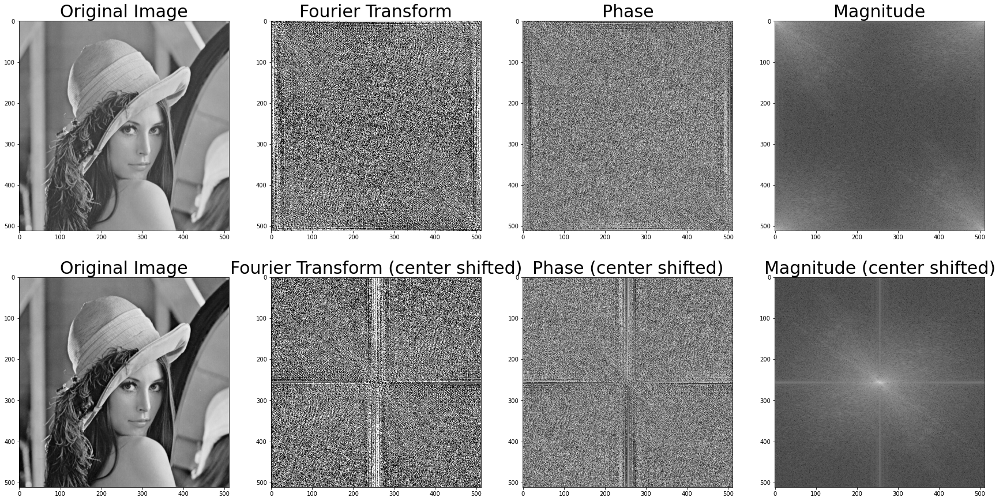

In [ ]:
lena = cv2.imread("Lena.png", 0)
view_fourier(lena)

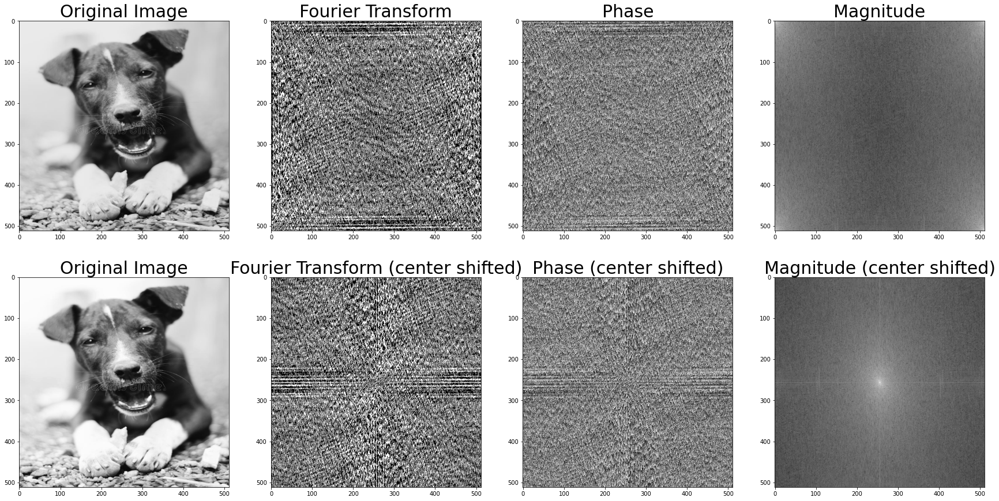

In [ ]:
dog = cv2.imread("dog.tif", 0)
dog = cv2.resize(dog, (512, 512))       # resizing so that dims are equal to 2^n. 
                                        # (512, 512) is chosen since lena image is of size (512, 512)
view_fourier(dog)

# Question 6 and 7
Swap phase of dog image and lena image and display the output.

In [ ]:
# Function to convert polar coordinates to rectangular coordinates
def rect_to_polar(magnitude, angle):
    return magnitude * np.exp(1j * angle)

# Vectorized function to convert polar coordinates to rectangular coordinates
rect_to_polar_vec = np.vectorize(rect_to_polar)

In [ ]:
def IFFT_1D(signal):

    def worker(signal):
        n = len(signal)
        if n == 1:
            return signal

        w = np.power(np.e, 2 * np.pi * (1j) / n)
        signal_e = [signal[i] for i in range(len(signal)) if i%2 == 0]
        signal_o = [signal[i] for i in range(len(signal)) if i%2 == 1]

        SIGNAL = [0] * n
        SIGNAL_E = worker(signal_e)
        SIGNAL_O = worker(signal_o)

        n2 = round(n/2)
        for i in range(n2):
            SIGNAL[i] = SIGNAL_E[i] + np.power(w, i) * SIGNAL_O[i]
            SIGNAL[i+n2] = SIGNAL_E[i] - np.power(w, i) * SIGNAL_O[i]

        return SIGNAL
    return np.asarray(worker(signal)) / len(signal)

def IFFT_2D(img):
    rows_FFT = []
    for i in img:
        rows_FFT.append(IFFT_1D(i))
    
    cols_FFT = np.asarray(rows_FFT, dtype=np.complex).T
    IMG = []
    for i in cols_FFT:
        IMG.append(IFFT_1D(i))
    return np.asarray(IMG).T

[0 1 2 3 4 5 6 7]
[(28+0j), (-4+9.65685424949238j), (-4.000000000000001+4j), (-4.000000000000002+1.6568542494923797j), (-4+0j), (-3.9999999999999996-1.6568542494923797j), (-3.999999999999999-4j), (-3.999999999999998-9.65685424949238j)]
[0.+0.00000000e+00j 1.-2.71834567e-16j 2.+4.44089210e-16j
 3.+3.82856870e-16j 4.+0.00000000e+00j 5.-4.97899625e-17j
 6.-4.44089210e-16j 7.-6.12323400e-17j]


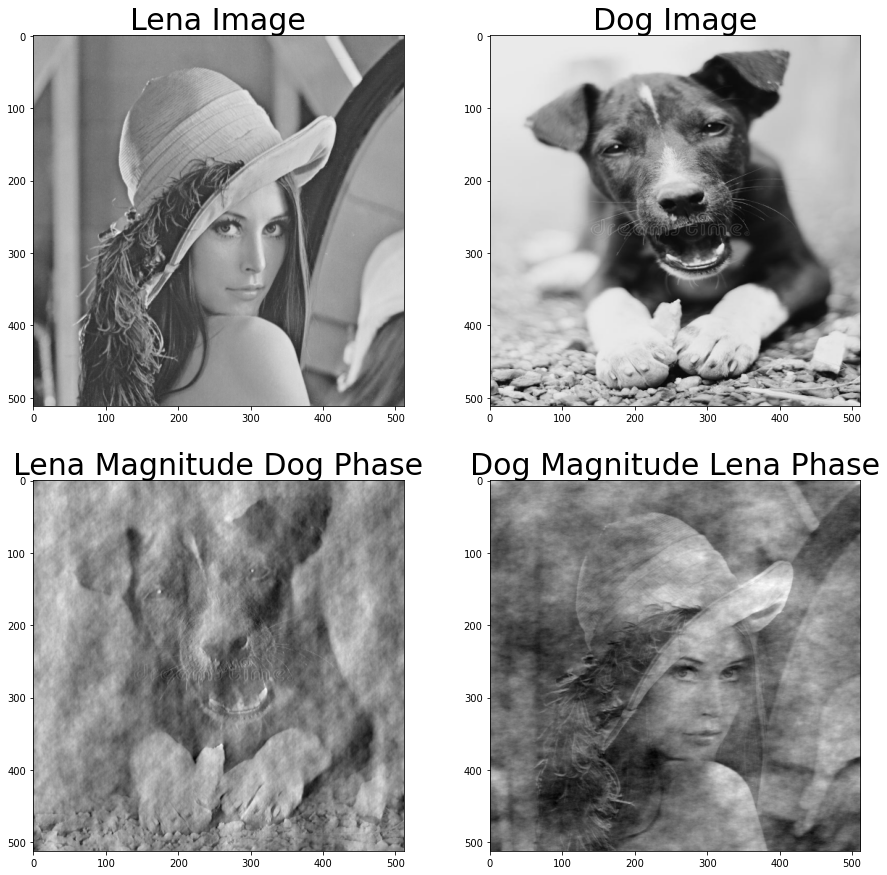

In [ ]:
lena = cv2.imread("Lena.png", 0)
dog = cv2.imread("dog.tif", 0)
dog = cv2.resize(dog, (512, 512))       # resizing so that dims are equal to 2^n. 
                                        # (512, 512) is chosen since lena image is of size (512, 512)

lena_FFT = FFT_2D(lena)
dog_FFT = FFT_2D(dog)

lena_magnitude = np.absolute(lena_FFT)
lena_phase = np.angle(lena_FFT)

dog_magnitude = np.absolute(dog_FFT)
dog_phase = np.angle(dog_FFT)

lena_mag_dog_phase_FFT = rect_to_polar_vec(lena_magnitude, dog_phase)
lena_mag_dog_phase = IFFT_2D(lena_mag_dog_phase_FFT)

dog_mag_lena_phase_FFT = rect_to_polar_vec(dog_magnitude, lena_phase)
dog_mag_lena_phase = IFFT_2D(dog_mag_lena_phase_FFT)

fig, elements=plt.subplots(nrows=2, ncols=2, figsize=(15, 15))

elements[0,0].imshow(cv2.cvtColor(lena, cv2.COLOR_BGR2RGB))
elements[0,0].set_title("Lena Image", fontsize=30)
elements[0,1].imshow(cv2.cvtColor(dog, cv2.COLOR_BGR2RGB))
elements[0,1].set_title("Dog Image", fontsize=30)
elements[1,0].imshow(np.real(lena_mag_dog_phase), cmap='gray')
elements[1,0].set_title("Lena Magnitude Dog Phase", fontsize=30)
elements[1,1].imshow(np.real(dog_mag_lena_phase), cmap='gray')
elements[1,1].set_title("Dog Magnitude Lena Phase", fontsize=30)

plt.show()